In [ ]:
import time
from datetime import datetime
import math
import random
from pathlib import Path
from functools import partial
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn import metrics
import torch
from torch import nn
import torch.nn.functional as F
import torchaudio
import torchvision
from tqdm.notebook import tqdm

pd.set_option("display.max_columns", None)

# Data

In [2]:
def add_secondary_lable(df):
    name2label = {k: v.label.unique()[0] for k, v in df.groupby('gensp')}
    df.loc[:, 'label2'] = None
    for i in range(df.shape[0]):
        sec_label = df.iloc[i].also
        if sec_label == '[]':
            continue
        sec_label = sec_label.strip("[]").replace("'", "").split(',')
        sec_label_ids = []
        for l in sec_label:
            l = '_'.join(l.strip().lower().split(' '))
            lid = name2label.get(l, -1)
            if lid == -1:
                continue
            sec_label_ids.append(lid)
        if len(sec_label_ids) != 0:
            df.at[i, 'label2'] = sec_label_ids
    return df

In [3]:
class XCDataset(torch.utils.data.Dataset):

    def __init__(self, df, sample_dur=3, cropping='multi_peak', validation=False, num_peaks=8, test=False, num_classes=76, use_pie=False):
        """
        args:
            df - a pandas DataFrame containing the recordings information and their path on the hard disk.
            sample_dur - size of the to be cropped window(s) in seconds
            cropping - set to "multi_peak" for peak-aggregation model, "peak" for peak-crop model, and "random" for random-crop model.
            validation - prepare the batches in deterministic mode for validation
            num_peaks - number of windows to crop from the recordings. This is used for validation and also in peak-aggregation method.
            num_classes - number of output categories (species) in the dataset. If None, it will be calculated from the 'df' based on maximum label value.
            use_pie - If True, it will use the Partial Instance Exchange augmentation.
        """
        super().__init__()
        assert not (validation and test), 'set either validation or test to False. In training mode, set both to False.'
        assert cropping in ['random', 'peak', 'multi_peak']
        self.sample_dur = sample_dur
        self.sr = 32_000  # I already resampled all files to 32 kHz for faster loading.
        self.df = df
        self.num_samples = sample_dur * self.sr  # number of audio wave samples based on window size in second and sampling rate
        self.cropping = cropping
        self.validation = validation
        self.num_peaks = num_peaks
        self.test = test
        self.num_classes = num_classes
        self.resampler = partial(torchaudio.functional.resample, new_freq=self.sr, lowpass_filter_width=64, rolloff=0.9475937167399596, resampling_method="sinc_interp_kaiser", beta=14.769656459379492)
        self.use_pie = use_pie

    def __getitem__(self, idx):
        if self.test:
            return self.load_test(idx)
        if self.validation:
            return self.load_val(idx)
        return self.load_train(idx)

    def __len__(self):
        return self.df.shape[0]

    def get_cropped_windows(self, idx):
        uri, dur, peaks, gensp = self.df.iloc[idx][['path', 'length', 'peaks', 'gensp']]
        
        if self.cropping == 'multi_peak':  # we are preparing data for peak-aggregation
            x, sr = torchaudio.load(uri=uri)
            x = x.mean(dim=0, keepdim=False)
            x = self.resampler(x, sr)  # this a no-op if already resampled the dataset to 32 kHz
            assert x.dim() == 1

            # we only do this in training for the sake of batching since the sizes should match along all axis, including the instance/peak axis.
            if self.sample_dur > dur: # the recording is too short. add negligible noise to prevent accidental degeneracies in norm layers and retun the right size
                x_peak_windows = [x] + [x + torch.randn(x.shape) * 0.05 for _ in range(self.num_peaks-1)]
                return x_peak_windows

            # mange peak sampling and edge cases
            max_offset = (dur - self.sample_dur) * self.sr
            if gensp == 'NAB':  # this class serves as ghost or non-bird, so empty background, noise, peak location, etc. all are welcomed!
                peaks = [int(random.random() * max_offset) for _ in range(self.num_peaks)]
            elif len(peaks) < self.num_peaks: # we only do this in training for the sake of batching since the sizes should match along all axis, including the instance/peak axis.
                extra_size = self.num_peaks - len(peaks)  # how many peaks the recording lacks for the default batching size
                extra_peaks = [int(random.random() * max_offset) for _ in range(extra_size)] # take random places, this is better since the recording might be short, sparse, or peak finding has failed. 
                peaks = peaks + extra_peaks
            else:  # ok, the recording is long, and we have many peaks
                peaks = np.random.choice(peaks, size=self.num_peaks, replace=False).tolist()
                if self.num_peaks > 1:  # in peak aggregation, replace one peak with a random crop, potentially a better exploration to alleviate the peak-finding shortcomings
                    peaks[-1] = int(random.random() * max_offset)

            # crop around the peak locations and return the windows 
            x_peak_windows = []
            half_window = self.num_samples // 2
            for p in peaks:
                offset = max(0, p + random.randint(-3200, 3200) - half_window) # add a jitter and put the peak at the center of cropped window
                x_peak_windows.append(x[offset:offset+self.num_samples])
            return x_peak_windows

        elif self.cropping == 'peak':  # data for peak-crop model
            if self.sample_dur > dur:
                offset = 0
            elif gensp == 'NAB':
                offset = int(random.random() * (dur - self.sample_dur) * self.sr)
            else:
                offset = random.choice(peaks) + random.randint(-3200, 3200)
            offset = max(0, offset - (self.num_samples // 2))  # put peak location at the center of window if possible
            x, sr = torchaudio.load(uri=uri, frame_offset=offset, num_frames=self.num_samples)
            x = x.mean(dim=0, keepdim=False)
            x = self.resampler(x, sr)  # this a no-op if already resampled the dataset to 32 kHz
            assert x.dim() == 1
            return x
        
        elif self.cropping == 'random':
            offset = 0 if (self.sample_dur > dur) else int(random.random() * (dur - self.sample_dur) * self.sr)
            x, sr = torchaudio.load(uri=uri, frame_offset=offset, num_frames=self.num_samples)
            x = x.mean(dim=0, keepdim=False)
            x = self.resampler(x, sr)  # this a no-op if already resampled the dataset to 32 kHz
            assert x.dim() == 1
            return x
        
        else:
            raise ValueError(f'{self.cropping} method is not defined. You should have gotten an error sooner! did you change the code in __init__?')

    def make_multilable(self, idx):
        y, secondary_labels = self.df.iloc[idx][['label', 'label2']]
        if secondary_labels is not None:
            y_multi = [y] + secondary_labels
        else:
            y_multi = [y]
        y_multi = nn.functional.one_hot(torch.tensor(y_multi), num_classes=self.num_classes).amax(dim=0).reshape(1, -1)
        return y, y_multi
        
    def load_train(self, idx):
        y, y_multi = self.make_multilable(idx)
        x = self.get_cropped_windows(idx)
        return x, y, y_multi

    def load_val(self, idx):
        uri, dur, peaks, gensp = self.df.iloc[idx][['path', 'length', 'peaks', 'gensp']]
        y, y_multi = self.make_multilable(idx)
        x, sr = torchaudio.load(uri=uri)
        x = x.mean(dim=0, keepdim=False)
        x = self.resampler(x, sr)
        x = list(x.split(self.num_samples))
        if len(x) > self.num_peaks and x[-1].shape[0] < 16000:
            x = x[:-1]  # drop the short last chunk
        if len(x) < self.num_peaks:
            x = x * self.num_peaks  # repeat the entries of the list, e.g.: [obj_1, obj_2] * 2 = [obj_1, obj_2, obj_1, obj_2]
        elif len(x) > self.num_peaks:
            energys = [s.abs().sum() for s in x]  # use abs, square, or subtract mean of the whole signal and then square (variance), they're all pretty much the same.
            ranks = np.argsort(energys)[::-1]
            ranks = ranks[:self.num_peaks]
            x = [x[r] for r in ranks]
        x = x[:self.num_peaks]
        return x, y, y_multi

    def load_test(self, idx):
        uri, dur, peaks, gensp = self.df.iloc[idx][['path', 'length', 'peaks', 'gensp']]
        y, y_multi = self.make_multilable(idx)
        x, sr = torchaudio.load(uri=uri)
        x = x.mean(dim=0, keepdim=False)
        x = self.resampler(x, sr)
        x = list(x.split(self.num_samples))
        if len(x) > 1 and x[-1].shape[0] < 32000:
            x[-2] = torch.cat([x[-2], x[-1]], dim=0)  # append the last short chunk to previous one
            x = x[:-1]  # drop the redundant last chunk
        return x, y, y_multi
        
    def train_collate_fn(self, batch):
        x, y, y_multi = zip(*batch)
        y = torch.tensor(y, dtype=torch.int64)
        y_multi = torch.cat(y_multi).float()
        assert y.dim() == 1 and y_multi.dim() == 2
        batch_size = len(x)
        if self.cropping == 'multi_peak':
            x = [xji for xj in x for xji in xj]  # unwrap samples, each single input is multiple audio chunks here
            x = torch.nn.utils.rnn.pad_sequence(x, batch_first=True, padding_value=0.)  # gives a tensor of shape: (batch_size * number_of_peaks, window_size_samples)
            x = x.view(batch_size, self.num_peaks, x.shape[-1])
            if self.use_pie:  # partial instance exchange
                x = torch.cat([x[:, :self.num_peaks//2], x[:, self.num_peaks//2:].flip((0,))], dim=1)
                y_multi = torch.clamp(y_multi + y_multi.flip((0,)), 0., 1.)
        else:
            x = torch.nn.utils.rnn.pad_sequence(x, batch_first=True, padding_value=0.)
        return x, y, y_multi

    def eval_collate_fn(self, batch):
        x, y, y_multi = zip(*batch)
        y = torch.tensor(y, dtype=torch.int64)
        y_multi = torch.cat(y_multi).float()
        assert y_multi.dim() == 2 and y.dim() == 1
        batch_size = len(x)
        x = [xji for xj in x for xji in xj]  # x is a list of length batch_size that contains other lists of length num_peak of audio chunks
        x = torch.nn.utils.rnn.pad_sequence(x, batch_first=True, padding_value=0.)  # B*n, T
        if self.validation:
            x = x.view(batch_size, self.num_peaks, -1)
        elif self.test:
            assert batch_size == len(y) == len(y_multi) == 1, "batch_size should be 1 for test"
            x = x.view(1, x.shape[0], -1)
        else:
            raise ValueError('eval_collate_fn is not for training mode. Use train_collate_fn instead.')
        return x, y, y_multi

In [4]:
class DataTransformer(torch.nn.Module):

    def __init__(self, sr=32000, n_fft=1024, hop_length=256, n_mels=80):
        super().__init__()
        self.sr = sr
        self.n_fft = n_fft
        self.hop_length = hop_length
        self.n_mels = n_mels
        self.register_buffer("window", torch.hann_window(self.n_fft))
        self.register_buffer('mel_fb', torchaudio.functional.melscale_fbanks(n_fft // 2 + 1, 100.0, sr / 2.0, n_mels, sr, None, "htk"))
        self.db = torchaudio.transforms.AmplitudeToDB(top_db=80)

    def forward(self, x):
        """
        args:
            x: batch of waveforms of shape (batch_size or total number of peaks, time)
        """
        assert x.dim() == 2
        x = torchaudio.functional.spectrogram(x, 0, self.window, self.n_fft, self.hop_length, self.n_fft, 2, False)
        x = torch.matmul(x.transpose(-1, -2), self.mel_fb).transpose(-1, -2)
        assert x.dim() == 3
        x.unsqueeze_(1)   # B, 1, F, T, it should be 4D to be reproducible in torchaudio db
        x = self.db(x)
        x = self.minmax_normalizer(x)  # B, 1, F, T  float
        return x

    @staticmethod
    def minmax_normalizer(x):
        shape = x.shape
        x = x.flatten(1)
        min_ = x.min(1)[0].unsqueeze(1)
        max_ = x.max(1)[0].unsqueeze(1)
        x = (x - min_) / (max_ - min_ + 1e-9)
        x = x.reshape(shape)
        return x

# Model

In [5]:
class KV_SelfAttention_AutoPool(nn.Module):
    def __init__(self, in_dim=1280, hid_dim=None, num_heads=8, num_classes=None, per_class_query=False, autopool=False):
        super().__init__()
        
        assert num_heads >= 1
        if hid_dim is None:
            hid_dim = in_dim
        assert hid_dim % num_heads == 0, "hid_dim (or in_dim if hid_dim=None) must be divisible by num_heads."
        if per_class_query:
            assert num_classes is not None
        else:
            num_classes = 1
        
        self.num_classes = num_classes
        self.num_heads = num_heads
        self.head_dim = hid_dim // num_heads
        self.scale = self.head_dim ** -0.5  
        self.k = nn.Linear(in_dim, hid_dim)
        self.v = nn.Linear(in_dim, hid_dim)        
        self.cls_token = nn.Parameter(torch.rand(num_classes, hid_dim) * 0.1)
        self.tau = nn.Parameter(torch.ones(num_heads, num_classes)) if autopool else None
        self.out_proj = nn.Sequential(nn.Linear(hid_dim, hid_dim), nn.SiLU())
        
    def forward(self, x):
        batch_size, num_peaks, in_dim = x.shape
        q = self.cls_token.reshape(1, self.num_classes, -1).repeat(batch_size, 1, 1).reshape(batch_size, self.num_classes, self.num_heads, self.head_dim).permute(0, 2, 1, 3)  # B, H, C, d
        k = self.k(x).reshape(batch_size, num_peaks, self.num_heads, self.head_dim).permute(0, 2, 1, 3)  # B, H, P, d
        v = self.v(x).reshape(batch_size, num_peaks, self.num_heads, self.head_dim).permute(0, 2, 1, 3)  # B, H, P, d
        attn = (q * self.scale) @ k.transpose(-2, -1)  # B, H, C, d @ B, H, d, P -> B, H, C, P
        if self.tau is not None:
            attn = attn * self.tau.reshape(1, self.num_heads, self.num_classes, 1)
        attn = attn.softmax(dim=-1)
        x = attn @ v   # B, H, C, P @ B, H, P, d -> B, H, C, d
        x = x.permute(0, 2, 1, 3).reshape(batch_size, self.num_classes, -1)  # B, C, D
        if x.shape[1] == 1:  # it should be 1 when per_class_query=False
            x = x.squeeze(1)
        x = self.out_proj(x)  # B, [C], D; without per_class_query it's B, D
        return x, attn

In [6]:
# Remark: the proposed aggregation method has nothing to do with the architecture you are going to use here, nor it is trying to achieve the highest performance on this dataset.
# These experiments and models are merely tools to illustrate the utility of the method in robust training on weakly labeled long recordings.
class EffNetB1(nn.Module):
    def __init__(self, num_classes=76, hid_dim=None, peak_agg=False, per_class_query=False, autopool=False, num_heads=8):
        super().__init__()
        
        encoder = torchvision.models.efficientnet_b1(weights=None)
        feat_dim = encoder.classifier[1].in_features
        encoder.classifier[1] = nn.Flatten(start_dim=1)
        encoder.features[0][0] = nn.Conv2d(1, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)  # replace 1st RGB conv with grayscale
        self.encoder = encoder
        
        if hid_dim is None:
            hid_dim = feat_dim
        
        self.fc_drop = nn.Dropout(0.2)
        
        if peak_agg:
            self.agg = KV_SelfAttention_AutoPool(feat_dim, hid_dim, num_heads, num_classes, per_class_query, autopool)
        
        if peak_agg and per_class_query:  # every class gets its own specialized features
            self.fc_weight = nn.Parameter(torch.randn(1, num_classes, hid_dim))
            self.fc_bias = nn.Parameter(torch.zeros(num_classes))
            self.fc = lambda x: (self.fc_weight * x).sum(dim=-1) + self.fc_bias  # B, C, D * 1, C, D -> sum(dim=-1) -> B, C + ,C -> B, C logits
        else:
            self.fc = nn.Linear(hid_dim, num_classes, bias=True)
        
    def forward(self, x, return_features=False):
        '''
        x: input of shape (batch_size, num_peaks, 1, freq, time) if peak-agg mode else (batch_size, 1, freq, time)
        '''
        if x.dim() == 5:
            batch_size, num_peaks, num_channels, freq_bins, time_bins = x.shape
            x = x.view(batch_size * num_peaks, num_channels, freq_bins, time_bins)  # this architecture is agnostic to the instance dimension.
            h_enc = self.encoder(x)  # h is of shape (batch_size * num_peaks, 1280)
            h_enc = h_enc.reshape(batch_size, num_peaks, -1)
            h_agg, atten_weights = self.agg(h_enc)  # (batch_size, C, 1280) or (batch_size, 1280) depending on per_class_query
            h_agg = self.fc_drop(h_agg)
            logits = self.fc(h_agg)
            if return_features:
                return logits, h_enc, h_agg, atten_weights
        else:
            assert x.dim() == 4
            h = self.encoder(x)
            logits = self.fc(h)
            if return_features:
                return logits, h
        
        return logits

# Utils

In [7]:
class RiseRunDecayScheduler(torch.optim.lr_scheduler._LRScheduler):

    def __init__(self, optimizer, steps_in_epoch=None, warmup=1, constant=0, total_epochs=100, lowest_lr=1e-6):

        self.warmup = warmup * steps_in_epoch
        self.constant = self.warmup + (constant * steps_in_epoch)
        self.final_step = total_epochs * steps_in_epoch
        self.decay_interval = self.final_step - self.constant
        self.lowest_lr = lowest_lr
        super().__init__(optimizer)

    def get_lr(self):
        current_iteration = self.last_epoch
        if current_iteration <= self.warmup:
            factor = current_iteration / self.warmup
        elif current_iteration <= self.constant:
            factor = 1.0
        else:
            current_iteration = self.last_epoch - self.constant
            factor = 0.5 * (1 + math.cos(math.pi * current_iteration / self.decay_interval))

        return [lr * factor if (lr * factor) > self.lowest_lr else self.lowest_lr for lr in self.base_lrs]

In [8]:
def get_avg_posterior(y_true, y_pred, name2label=None, per_class_std=False):
    post_pos, post_neg = {}, {}
    for k, v in name2label.items():  # for each class and its assigned label:
        # separate positive and negative groups based on ground truth
        y_true_k = y_true[:, v]
        y_pred_k = y_pred[:, v]
        pos_idx = np.where(y_true_k == 1)[0]
        neg_idx = np.where(y_true_k == 0)[0]
        y_pred_k_pos, y_pred_k_neg = y_pred_k[pos_idx], 1 - y_pred_k[neg_idx]
        
        if per_class_std:
            post_pos[k] = (y_pred_k_pos.mean(), y_pred_k_pos.std())
            post_neg[k] = (y_pred_k_neg.mean(), y_pred_k_neg.std())
        else:
            post_pos[k] = y_pred_k_pos.mean()  # P(C_k = 1 | X_k)
            post_neg[k] = y_pred_k_neg.mean()  # P(C_k = 0 | X_/k)

    # these are summaries across all classes, which themselves are based on the average of their samples' posteriors/predictions
    pmu = np.mean([v[0] if per_class_std else v for v in post_pos.values()])
    psd = np.std([v[0] if per_class_std else v for v in post_pos.values()])
    nmu = np.mean([v[0] if per_class_std else v for v in post_neg.values()])
    nsd = np.std([v[0] if per_class_std else v for v in post_neg.values()])
    post_pos['mu'] = pmu
    post_pos['std'] = psd
    post_neg['mu'] = nmu
    post_neg['std'] = nsd
    return post_pos, post_neg

In [72]:
def get_avg_posterior_difference(y_true, y_pred_m1, y_pred_m2):
    """
    for each class, separate the data points belonging to that class (positive ones) from the rest (negative ones).
    Gather the difference of posteriors in each group in all classes. 
    """
    cache = {'diff_positive_mu': [], 'diff_positive_sigma': [], 'diff_negative_mu': [], 'diff_negative_sigma': []}
    for k in range(y_true.shape[1]):
        y_true_k = y_true[:, k]
        y_pred_m1_k = y_pred_m1[:, k]
        y_pred_m2_k = y_pred_m2[:, k]
        pos_idx, neg_idx = np.where(y_true_k == 1)[0], np.where(y_true_k == 0)[0]
        # calculate the differences in each group
        y_pred_m1_k_pos, y_pred_m1_k_neg = y_pred_m1_k[pos_idx], 1 - y_pred_m1_k[neg_idx]
        y_pred_m2_k_pos, y_pred_m2_k_neg = y_pred_m2_k[pos_idx], 1 - y_pred_m2_k[neg_idx]
        diff_pos = y_pred_m1_k_pos - y_pred_m2_k_pos
        diff_neg = y_pred_m1_k_neg - y_pred_m2_k_neg
        # average and variation within the class
        cache['diff_positive_mu'].append(diff_pos.mean())
        cache['diff_positive_sigma'].append(diff_pos.std())
        cache['diff_negative_mu'].append(diff_neg.mean())
        cache['diff_negative_sigma'].append(diff_neg.std())
    cache['diff_positive_mu'] = np.array(cache['diff_positive_mu'])
    cache['diff_positive_sigma'] = np.array(cache['diff_positive_sigma'])
    cache['diff_negative_mu'] = np.array(cache['diff_negative_mu'])
    cache['diff_negative_sigma'] = np.array(cache['diff_negative_sigma'])
    return cache

In [10]:
def get_class_wise_tuned_thresholds(y_true, y_pred):
    thresholds = np.linspace(0.01, .99, 51).round(2)
    num_classes = y_pred.shape[1]
    class_wise_tuned_thresholds = np.zeros(num_classes)
    class_wise_best_scores = np.zeros(num_classes)
    for t in thresholds:
        y_pred_hard = np.float32(y_pred >= t)
        class_wise_scores_at_t = metrics.f1_score(y_true, y_pred_hard, average=None, zero_division=0)
        for c in range(num_classes):
            # there's always a range of values with the same performance on any given dataset. we keep the maximum threshold that gives highest score.
            if class_wise_scores_at_t[c] >= class_wise_best_scores[c]:
                class_wise_best_scores[c] = class_wise_scores_at_t[c]
                class_wise_tuned_thresholds[c] = t
    return class_wise_tuned_thresholds.reshape(1, -1)
    
def get_metrics(y_true, y_pred, prefix='', decision_threshold=0.5, tune_thresholds=False, name2label=None):
    if tune_thresholds:
        decision_threshold = get_class_wise_tuned_thresholds(y_true, y_pred)
    y_pred_hard = np.float32(y_pred >= decision_threshold)
    p, r, f, _ = metrics.precision_recall_fscore_support(y_true, y_pred_hard, average='macro', zero_division=0)
    cache = {prefix+'f1_macro': f * 100,
             prefix+'precision': p * 100,
             prefix+'recall': r * 100,
             prefix+'f1_micro': metrics.f1_score(y_true, y_pred_hard, average='micro', zero_division=0) * 100,
             prefix+'auc': metrics.roc_auc_score(y_true, y_pred, average='macro') * 100,
             prefix+'mAP': metrics.average_precision_score(y_true, y_pred, average='macro') * 100,
             }
    if tune_thresholds:
        cache[prefix+'decision_threshold'] = decision_threshold.reshape(-1)
    post_pos, post_neg = get_avg_posterior(y_true, y_pred, name2label)
    cache[prefix+'post_pos_mu'] = post_pos['mu']
    cache[prefix+'post_pos_std'] = post_pos['std']
    cache[prefix+'post_neg_mu'] = post_neg['mu']
    cache[prefix+'post_neg_std'] = post_neg['std']
    return cache

In [11]:
def train_step(model, optimizer, train_loader, data_transformer, scheduler=None, device='cuda', use_amp=True, return_labels=False, name2label=None):
    model.train()
    y_true, y_pred, losses = [], [], []
    
    for x, y, y_multi in tqdm(train_loader, leave=False):
        x, y_multi = x.to(device), y_multi.to(device)
        
        if x.dim() == 3:  # we are using peak aggregation
            batch_size, num_peaks, _ = x.shape
            x = x.view(batch_size * num_peaks, -1)
            with torch.no_grad():
                x = data_transformer(x)
            _, _, freq_bins, time_bins = x.shape   # B*P, 1, F, T
            x = x.view(batch_size, num_peaks, 1, freq_bins, time_bins)
        else:  # regular setup without peak aggregation
            with torch.no_grad():
                x = data_transformer(x)
                
        with torch.autocast(device_type=device, dtype=torch.bfloat16, enabled=use_amp):
            logits = model(x)
        logits = logits.float()
        
        loss = F.binary_cross_entropy_with_logits(logits, y_multi)
        loss.backward()
        optimizer.step()
        if scheduler is not None:
            scheduler.step()
        optimizer.zero_grad()
        
        losses.append(float(loss.detach().item()))
        y_true.append(y_multi.cpu().float().numpy())
        y_pred.append(logits.detach().cpu().sigmoid().numpy())

    cache = get_metrics(np.concatenate(y_true), np.concatenate(y_pred), name2label=name2label)
    cache['loss'] = float(np.mean(losses))
    if return_labels:
        cache['y_true'] = np.concatenate(y_true)
        cache['y_pred'] = np.concatenate(y_pred)
    return cache

In [12]:
@torch.inference_mode()
def evaluate(model, data_loader, data_transformer, device='cuda', use_amp=True, path2save=None, peak_agg_mode=False, prefix='val_', return_labels=False, name2label=None):
    model.eval()
    y_true, y_pred, losses, y_pred_weak = [], [], [], []
    
    for x, y, y_multi in tqdm(data_loader, leave=False):
        x, y_multi = x.to(device), y_multi.to(device)
        
        assert x.dim() == 3
        batch_size, num_segments, _ = x.shape
        x = x.view(batch_size * num_segments, -1)
        x = data_transformer(x)
        _, _, freq_bins, time_bins = x.shape   # B*P, 1, F, T
        if peak_agg_mode:
            x = x.view(batch_size, num_segments, 1, freq_bins, time_bins)
        
        with torch.autocast(device_type=device, dtype=torch.bfloat16, enabled=use_amp):
            logits = model(x)
        logits = logits.float()
        if not peak_agg_mode:  # if the model is not aggregating, we average
            logits = logits.reshape(batch_size, num_segments, -1).mean(dim=1)
        
        loss = F.binary_cross_entropy_with_logits(logits, y_multi)
        losses.append(float(loss.item()))
        
        yhat = logits.cpu().sigmoid().round().float()
        assert yhat.shape[0] == batch_size == y.shape[0]
        y_pred_weak.extend([yh_i[y_i] == 1 for y_i, yh_i in zip(y, yhat)])
        
        y_true.append(y_multi.cpu().float().numpy())
        y_pred.append(logits.cpu().sigmoid().float().numpy())
        
    cache = get_metrics(np.concatenate(y_true), np.concatenate(y_pred), prefix, name2label=name2label)
    cache[prefix+'loss'] = float(np.mean(losses))
    cache[prefix+'weak_accuracy'] = np.mean(y_pred_weak) * 100
    if path2save is not None:
        _ = pd.DataFrame(cache, index=[0]).to_csv(path2save)
    if return_labels:
        cache['y_true'] = np.concatenate(y_true)
        cache['y_pred'] = np.concatenate(y_pred)
    return cache

In [13]:
def train_run(model, optimizer, train_loader, val_loader, data_transformer, epochs, scheduler=None, device='cuda', use_amp=True, state_save_path='state.pt', history_save_path='history.csv', val_metric='val_f1_macro', 
              peak_agg_mode=False, compile_=False, name2label=None):

    if compile_:
        opt_model = torch.compile(model, mode='default') 
    else:
        opt_model = model
    best_score, best_epoch, history = 0, 0, None
    pbar = tqdm(range(epochs))
    for e in pbar:
        cache = train_step(opt_model, optimizer, train_loader, data_transformer, scheduler, device, use_amp, name2label=name2label)
        val_cache = evaluate(opt_model, val_loader, data_transformer, device, use_amp, peak_agg_mode=peak_agg_mode, prefix='val_', name2label=name2label)
        cache = cache | val_cache
        if history is None:
            history = {k: [] for k in cache.keys()}
        for k, v in cache.items():
            history[k].append(v)
        _ = pd.DataFrame(history).to_csv(history_save_path)
        if val_cache[val_metric] >= best_score:
            torch.save(model.state_dict(), state_save_path)
            best_score, best_epoch = val_cache[val_metric], e + 1
        message = ' '.join([f'{k}:{v[e]:.3f}' for k, v in history.items()]) + f' best: {best_score:.2f} at {best_epoch}'
        pbar.set_description(message)
    return history

In [14]:
def plot_history(history, make_figure=True, show=True, figsize=(20, 4*5), prefix=''):
    if make_figure:
        _ = plt.figure(figsize=figsize, layout='constrained')
    
    plt.subplot(10,1,1)
    plt.plot(history['loss'], label=prefix+'loss')
    plt.plot(history['val_loss'], label=prefix+'val_loss')
    plt.legend(loc='upper right', ncols=4)

    plt.subplot(10,1,2)
    plt.plot(history['auc'], label=prefix+'auc')
    plt.plot(history['val_auc'], label=prefix+'val_auc')
    plt.legend(loc='lower right', ncols=4)

    plt.subplot(10,1,3)
    plt.plot(history['mAP'], label=prefix+'mAP')
    plt.plot(history['val_mAP'], label=prefix+'val_mAP')
    plt.legend(loc='lower right', ncols=4)
    
    plt.subplot(10,1,4)
    plt.plot(history['f1_macro'], label=prefix+'f1_macro')
    plt.plot(history['val_f1_macro'], label=prefix+'val_f1_macro')
    plt.legend(loc='lower right', ncols=4)

    plt.subplot(10,1,5)
    plt.plot(history['precision'], label=prefix+'precision')
    plt.plot(history['val_precision'], label=prefix+'val_precision')
    plt.legend(loc='lower right', ncols=4)

    plt.subplot(10,1,6)
    plt.plot(history['recall'], label=prefix+'recall')
    plt.plot(history['val_recall'], label=prefix+'val_recall')
    plt.legend(loc='lower right', ncols=4)

    plt.subplot(10,1,7)
    plt.plot(history['f1_micro'], label=prefix+'f1_micro')
    plt.plot(history['val_f1_micro'], label=prefix+'val_f1_micro')
    plt.legend(loc='lower right', ncols=4)

    plt.subplot(10,1,8)
    # plt.plot(history['weak_accuracy'], label=prefix+'weak_accuracy') I didn't compute this for train set.
    plt.plot(history['val_weak_accuracy'], label=prefix+'val_weak_accuracy')
    plt.legend(loc='lower right', ncols=4)
    
    plt.subplot(10,1,9)
    mu = np.array(history['post_pos_mu'])
    s = np.array(history['post_pos_std'])
    plt.plot(mu, label=prefix+'post pos $\mu$')
    plt.fill_between(range(mu.shape[0]),mu+s, mu-s, alpha=.2, label=prefix+'post pos $\sigma$')
    mu = np.array(history['val_post_pos_mu'])
    s = np.array(history['val_post_pos_std'])
    plt.plot(mu, label=prefix+'val post pos $\mu$')
    plt.fill_between(range(mu.shape[0]),mu+s, mu-s, alpha=.2, label=prefix+'val post pos $\sigma$')
    plt.legend(loc='lower right', ncols=4)
    
    plt.subplot(10,1,10)
    mu = np.array(history['post_neg_mu'])
    s = np.array(history['post_neg_std'])
    plt.plot(mu, label=prefix+'post neg $\mu$ ')
    plt.fill_between(range(mu.shape[0]),mu+s, mu-s, alpha=.2, label=prefix+'post neg $\sigma$')
    mu = np.array(history['val_post_neg_mu'])
    s = np.array(history['val_post_neg_std'])
    plt.plot(mu, label=prefix+'val post neg $\mu$ ')
    plt.fill_between(range(mu.shape[0]),mu+s, mu-s, alpha=.2, label=prefix+'val post neg $\sigma$')
    plt.legend(loc='lower right', ncols=4)
    if show:
    # plt.savefig('')
        plt.show()

# Experiments

## Config

In [16]:
# setup:
# mind your CPU, RAM, and GPU if you want to play with these; I had a A6000 GPU with 48 GiB GPU RAM, 64 CPU, and 192 GiB RAM.
# if you get out of memory:
# 1) reduce the num_train_peaks
# 2) reduce sample_dur
# 3) reduce num_val_segments. worst case set it to 1, you'll get similar-enough results.
# 4) reduce the batch-size in data loader (defined further down).
# Note: if you are on a windows machine, you can't use multiprocessing in notebook, 
# set the num_workers=0 in all data loaders. Otherwise, put this notebook code into a script and create your data loader inside "if __name__ == '__main__':".

config = {
    'sample_dur': 3,  # 1, 3, 5, 7 are the ones I used in the paper
    'num_val_segments': 8,  # this was fixed to 16 in the paper
    'epochs': 100,
    'use_amp': True,
    'device': 'cuda',
    'crop_method': 'multi_peak',  # options: [random, peak, multi_peak]; 'multi_peak' if you are using aggregation model
    
    # the following args are only relevant when crop_method is multi_peak
    'num_train_peaks': 8,         # this was fixed at 8 in the paper
    'num_heads': 8,               # it was 8 in the paper
    'autopool': True,             # use learnable temperature in each attention head
    'per_class_query': False,     # each class gets a separet query/cls token and temperature per head if autopool is True (don't use this, it's bad. It was for the sake of one experiment in paper, I put it here for completeness.)
    'use_pie': True,             # partial instance exchange augmentation
}

par_dir = Path(f'logs/')
Path.mkdir(Path(par_dir), parents=True, exist_ok=True)
time_stamp = datetime.now().strftime("%Y_%m_%d_%H_%M_%S")
experiment_name = f"{config['crop_method']}"
if config['crop_method'] == 'multi_peak':
    experiment_name += f"{config['num_train_peaks']}"
    if config['per_class_query']:
        experiment_name += '_Cquery'
    else:
        experiment_name += '_1query'
    if config['autopool']:
        experiment_name += '_autopool'
    if config['use_pie']:
        experiment_name += '_pie'
experiment_name += f"_{config['sample_dur']}sec_{config['epochs']}epochs_{time_stamp}"
history_save_path = par_dir.joinpath(experiment_name + '_history.csv')
state_save_path = par_dir.joinpath(experiment_name + '_state.pt')
test_save_path = par_dir.joinpath(experiment_name + '_test.csv')
print(history_save_path, state_save_path, test_save_path, sep='\n')

logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_25_14_49_48_history.csv
logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_25_14_49_48_state.pt
logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_25_14_49_48_test.csv


## Preparing data and plotting a few samples

In [17]:
# data
df = pd.read_csv('/path/to/xc_curated_metadata.csv')
df.peaks = df.peaks.apply(lambda x: [int(s) for s in x.replace(' ', '').strip('[]').replace("'", '').split(',')])
df = add_secondary_lable(df.copy())
test_df = df[df.split == 2].reset_index(drop=True)
val_df = df[df.split == 1].reset_index(drop=True)
train_df = df[df.split == 0].reset_index(drop=True)
print(train_df.shape, val_df.shape, test_df.shape)
print(train_df.label.nunique(), val_df.label.nunique(), test_df.label.nunique())
num_classes = train_df.label.nunique()
del df

(6856, 45) (2356, 45) (3800, 45)
76 76 76


In [18]:
label2name = {v.label.unique()[0]: ' '.join(k.split('_')).capitalize() for k, v in train_df.groupby('gensp')}
label2name[0] = 'Not-A-Bird'
name2label = {v: k for k, v in label2name.items()}

In [19]:
data_transformer = DataTransformer(n_fft=1024, hop_length=256, n_mels=80)
data_transformer.to(config['device'])
data_transformer.requires_grad_(False);

In [20]:
train_dataset = XCDataset(train_df, config['sample_dur'], config['crop_method'], num_peaks=config['num_train_peaks'], num_classes=num_classes, use_pie=config['use_pie'])
train_loader = torch.utils.data.DataLoader(train_dataset, shuffle=True, batch_size=64, num_workers=32, pin_memory=False, collate_fn=train_dataset.train_collate_fn, persistent_workers=True)

val_dataset = XCDataset(val_df, sample_dur=5, validation=True, num_peaks=config['num_val_segments'], num_classes=num_classes)
val_loader = torch.utils.data.DataLoader(val_dataset, shuffle=False, batch_size=8, num_workers=32, pin_memory=False, collate_fn=val_dataset.eval_collate_fn, persistent_workers=True)

**let's test the data loader soundness and visualize some training samples**

In [21]:
for x, y, y_multi in tqdm(train_loader):
    continue
print(x.shape, y.shape, y_multi.shape)

if x.dim() == 3:  # we are using peak aggregation
    batch_size, num_peaks, _ = x.shape
    x = x.view(batch_size * num_peaks, -1)
    with torch.no_grad():
        x = data_transformer(x.to(config['device']))
        x = x.cpu()
    _, _, freq_bins, time_bins = x.shape   # B*P, 1, F, T
    x = x.view(batch_size, num_peaks, 1, freq_bins, time_bins)
else:  # regular setup without peak aggregation
    with torch.no_grad():
        x = data_transformer(x.to(config['device']))
        x = x.cpu()
print(x.shape)

  0%|          | 0/108 [00:00<?, ?it/s]

torch.Size([8, 8, 96000]) torch.Size([8]) torch.Size([8, 76])
torch.Size([8, 8, 1, 80, 376])


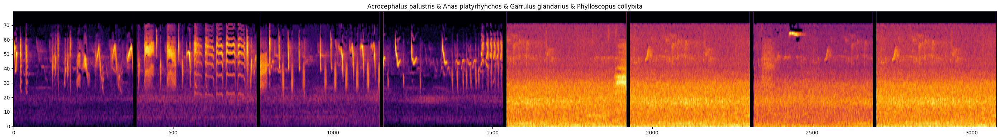

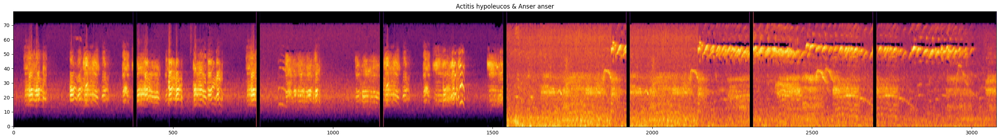

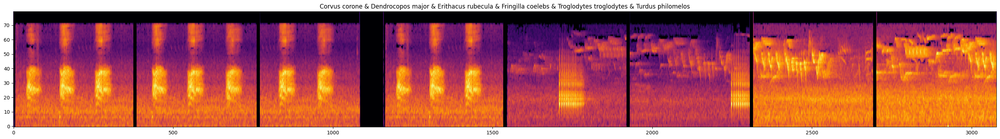

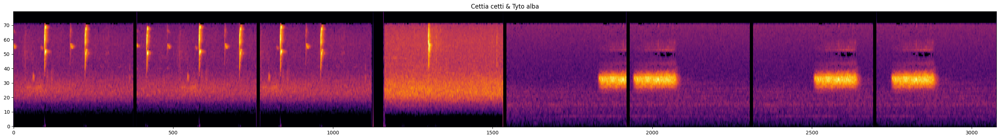

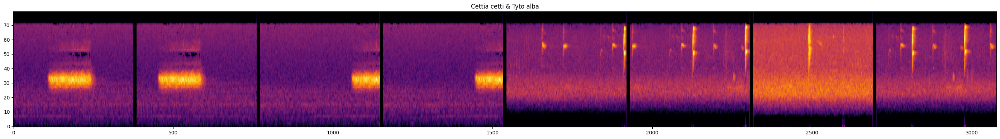

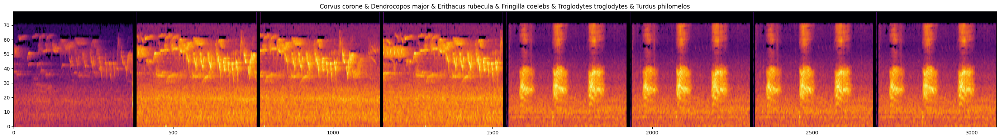

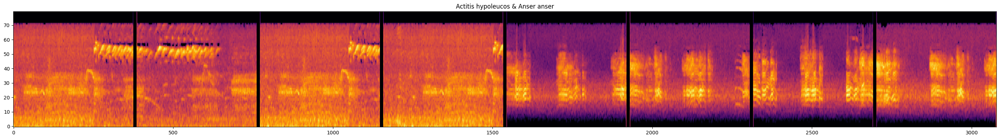

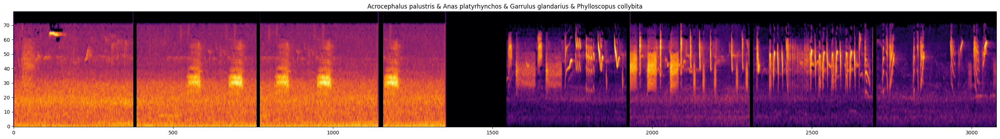

In [22]:
if x.dim() == 5:
    for i in range(x.shape[0]):  # the sample in batch to visualize
        x_vis = torch.chunk(x[i], x.shape[1])  # separate peak windows
        x_vis = [F.pad(xip, (0, 10)) for xip in x_vis[:-1]] + [x_vis[-1]]  # pad between windows for better visualization.
        x_vis = torch.cat(x_vis, dim=3).squeeze().numpy()  # make a train window
        title = ' & '.join([train_df[train_df.label == l].gensp.iloc[0].capitalize().replace('_', ' ') for l in torch.where(y_multi[i] > 0)[0].tolist()])
        _ = plt.figure(figsize=(28, 4)); plt.imshow(x_vis, origin='lower', cmap='inferno', aspect='auto'); plt.title(title); plt.tight_layout(); plt.show()
else:
    for i in range(x.shape[0]):  # the sample in batch to visualize
        title = ' & '.join([train_df[train_df.label == l].gensp.iloc[0].capitalize().replace('_', ' ') for l in torch.where(y_multi[i] > 0)[0].tolist()])
        _ = plt.figure(figsize=(20, 4)); plt.imshow(x[i, 0], origin='lower', cmap='inferno', aspect='auto'); plt.title(title); plt.tight_layout(); plt.show()

**Let's do the same for validation set**

In [23]:
for x, y, y_multi in tqdm(val_loader):
    continue
print(x.shape, y.shape, y_multi.shape)

batch_size, num_segments, _ = x.shape
x = x.view(batch_size * num_segments, -1)
with torch.no_grad():
    x = data_transformer(x.to(config['device']))
    x = x.cpu()
_, _, freq_bins, time_bins = x.shape   # B*P, 1, F, T
x = x.view(batch_size, num_segments, 1, freq_bins, time_bins)
print(x.shape)

  0%|          | 0/295 [00:00<?, ?it/s]

torch.Size([4, 8, 160000]) torch.Size([4]) torch.Size([4, 76])
torch.Size([4, 8, 1, 80, 626])


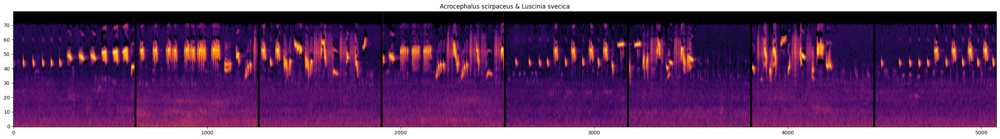

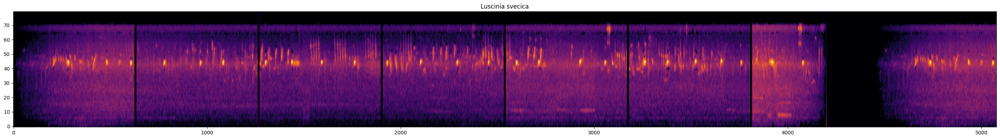

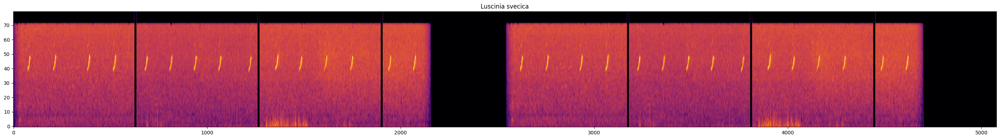

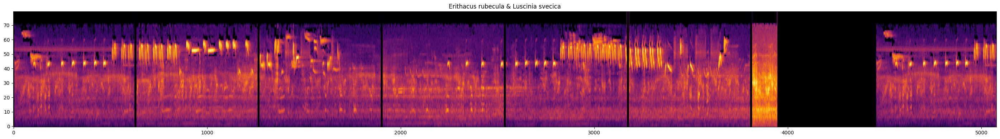

In [24]:
for i in range(x.shape[0]):  # the sample in batch to visualize
    x_vis = torch.chunk(x[i], x.shape[1])  # separate peak windows
    x_vis = [F.pad(xip, (0, 10)) for xip in x_vis[:-1]] + [x_vis[-1]]  # pad between windows for better visualization.
    x_vis = torch.cat(x_vis, dim=3).squeeze().numpy()  # make a train window
    title = ' & '.join([train_df[train_df.label == l].gensp.iloc[0].capitalize().replace('_', ' ') for l in torch.where(y_multi[i] > 0)[0].tolist()])
    _ = plt.figure(figsize=(28, 4)); plt.imshow(x_vis, origin='lower', cmap='inferno', aspect='auto'); plt.title(title); plt.tight_layout(); plt.show()

## Run

In [25]:
model = EffNetB1(num_classes,
                 peak_agg=True if config['crop_method'] == 'multi_peak' else False,
                 per_class_query=config['per_class_query'],
                 autopool=config['autopool'],
                 num_heads=config['num_heads'])
model.to(config['device']).train()
optimizer = torch.optim.Adam(model.parameters())
scheduler = RiseRunDecayScheduler(optimizer, steps_in_epoch=len(train_loader), warmup=10, constant=0, total_epochs=config['epochs'], lowest_lr=1e-5)
print(f'#parameters {sum(p.numel() for p in model.parameters()):_}')

#parameters 11_530_292


In [ ]:
history = train_run(model, optimizer, train_loader, val_loader, data_transformer, config['epochs'], scheduler, config['device'], config['use_amp'],
                    state_save_path, history_save_path, peak_agg_mode=True if config['crop_method'] == 'multi_peak' else False, compile_=False, name2label=name2label)

**Test and save the results**

In [ ]:
# load the best state from validation
print(state_save_path)
model.load_state_dict(torch.load(state_save_path))

In [28]:
test_dataset = XCDataset(test_df, sample_dur=3, test=True, num_classes=num_classes)
test_loader = torch.utils.data.DataLoader(test_dataset, shuffle=False, batch_size=1, num_workers=4, pin_memory=False, collate_fn=test_dataset.eval_collate_fn, persistent_workers=False)

In [ ]:
test_cache = evaluate(model,
                      test_loader,
                      data_transformer,
                      config['device'],
                      config['use_amp'],
                      test_save_path,
                      peak_agg_mode=True if config['crop_method'] == 'multi_peak' else False, prefix='test_',
                      return_labels=True,
                      name2label=name2label,
                     )

In [ ]:
# save the results to plot later
np.save(par_dir.joinpath(experiment_name + '_test_cache.npy'), test_cache)

In [32]:
test_cache.keys()

dict_keys(['test_f1_macro', 'test_precision', 'test_recall', 'test_f1_micro', 'test_auc', 'test_mAP', 'test_post_pos_mu', 'test_post_pos_std', 'test_post_neg_mu', 'test_post_neg_std', 'test_loss', 'test_weak_accuracy', 'y_true', 'y_pred'])

In [25]:
model.cpu()
del model, optimizer, scheduler
torch.cuda.empty_cache()

## Results

**Histories**

In [ ]:
# if you wanna plot histories, replace these with your own trained models history pathes
history_multipeak_pie = pd.read_csv('logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_09_11_38_37_history.csv', index_col=[0])
history_multipeak = pd.read_csv('logs/multi_peak8_1query_autopool_3sec_100epochs_2025_02_07_17_58_06_history.csv', index_col=[0])
history_peak = pd.read_csv('logs/peak_3sec_100epochs_2025_02_10_17_40_09_history.csv', index_col=[0])
history_rand = pd.read_csv('logs/random_3sec_100epochs_2025_02_10_10_25_22_history.csv', index_col=[0])
plot_history(history_multipeak_pie, make_figure=False, show=False, prefix='peak-agg-pie_')
plot_history(history_multipeak, show=False, figsize=(20, 30), prefix='peak-agg_')
plot_history(history_peak, make_figure=False, show=False, prefix='peak_')
plot_history(history_rand, make_figure=False, show=True, prefix='rand_')

**Test Results**

In [35]:
# replace these with your own test_cache pathes
test_cache_multipeak_pie = np.load('logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_09_11_38_37_test_cache.npy', allow_pickle=True).item()
test_cache_multipeak = np.load('logs/multi_peak8_1query_autopool_3sec_100epochs_2025_02_07_17_58_06_test_cache.npy', allow_pickle=True).item()
test_cache_peak = np.load('logs/peak_3sec_100epochs_2025_02_10_17_40_09_test_cache.npy', allow_pickle=True).item()
test_cache_rand = np.load('logs/random_3sec_100epochs_2025_02_10_10_25_22_test_cache.npy', allow_pickle=True).item()

In [36]:
results = {k: [] for k in test_cache_multipeak_pie.keys() if k not in ['y_pred', 'y_true']}
for k in results.keys():
    results[k].append(test_cache_multipeak_pie[k])
    results[k].append(test_cache_multipeak[k])
    results[k].append(test_cache_peak[k])
    results[k].append(test_cache_rand[k])
results['pie'] = [True, False, None, None]
results['autopool'] = [True, True, None, None]
results = {'model': ['peak-agg-pie', 'peak-agg', 'peak-crop', 'rand-crop']} | results
pd.DataFrame(results)

,model,test_f1_macro,test_precision,test_recall,test_f1_micro,test_auc,test_mAP,test_post_pos_mu,test_post_pos_std,test_post_neg_mu,test_post_neg_std,test_loss,test_weak_accuracy,pie,autopool
0,peak-agg-pie,67.888215,68.739778,69.376520,63.773650,95.063369,73.087934,0.700302,0.147572,0.983519,0.013961,0.053766,85.263158,True,True
1,peak-agg,69.283972,80.999587,62.134707,65.393939,94.135846,70.977720,0.622312,0.165007,0.995343,0.004346,0.084944,78.131579,False,True
2,peak-crop,58.013136,89.605771,44.592125,55.048278,94.145794,67.991433,0.452043,0.148451,0.996327,0.003878,0.057074,57.315789,None,None
3,rand-crop,58.349945,90.488205,44.891001,55.641977,94.805379,69.264652,0.455813,0.148833,0.995061,0.004917,0.049960,57.973684,None,None


**Test results after class-wise threshold tuning for metrics**

In [38]:
tuned_test_metric_multipeak_pie = get_metrics(test_cache_multipeak_pie['y_true'], test_cache_multipeak_pie['y_pred'], prefix='test_', tune_thresholds=True, name2label=name2label)
tuned_test_metric_multipeak = get_metrics(test_cache_multipeak['y_true'], test_cache_multipeak['y_pred'], prefix='test_', tune_thresholds=True, name2label=name2label)
tuned_test_metric_peak = get_metrics(test_cache_peak['y_true'], test_cache_peak['y_pred'], prefix='test_', tune_thresholds=True, name2label=name2label)
tuned_test_metric_rand = get_metrics(test_cache_rand['y_true'], test_cache_rand['y_pred'], prefix='test_', tune_thresholds=True, name2label=name2label)

results = {k: [] for k in tuned_test_metric_multipeak_pie.keys() if k not in ['y_pred', 'y_true', 'test_decision_threshold']}
for k in results.keys():
    results[k].append(tuned_test_metric_multipeak_pie[k])
    results[k].append(tuned_test_metric_multipeak[k])
    results[k].append(tuned_test_metric_peak[k])
    results[k].append(tuned_test_metric_rand[k])
results['pie'] = [True, False, None, None]
results['autopool'] = [True, True, None, None]
results = {'model': ['peak-agg-pie', 'peak-agg', 'peak-crop', 'rand-crop']} | results
pd.DataFrame(results)

,model,test_f1_macro,test_precision,test_recall,test_f1_micro,test_auc,test_mAP,test_post_pos_mu,test_post_pos_std,test_post_neg_mu,test_post_neg_std,pie,autopool
0,peak-agg-pie,73.051320,81.463806,67.307572,68.310798,95.063369,73.087934,0.700302,0.148540,0.983519,0.014053,True,True
1,peak-agg,71.420053,82.881518,63.866686,66.958337,94.135846,70.977720,0.622312,0.166089,0.995343,0.004374,False,True
2,peak-crop,67.664937,76.470598,61.651126,63.080591,94.145794,67.991433,0.452043,0.149424,0.996327,0.003903,None,None
3,rand-crop,68.578795,78.488769,61.844508,64.415737,94.805379,69.264652,0.455813,0.149809,0.995061,0.004950,None,None


**decision thresholds after tuning**

* I'm showing it here for multiple model in one plot. You can plot tuned thresholds from multiple runs of the same model (config) to see the variations shown in the paper.

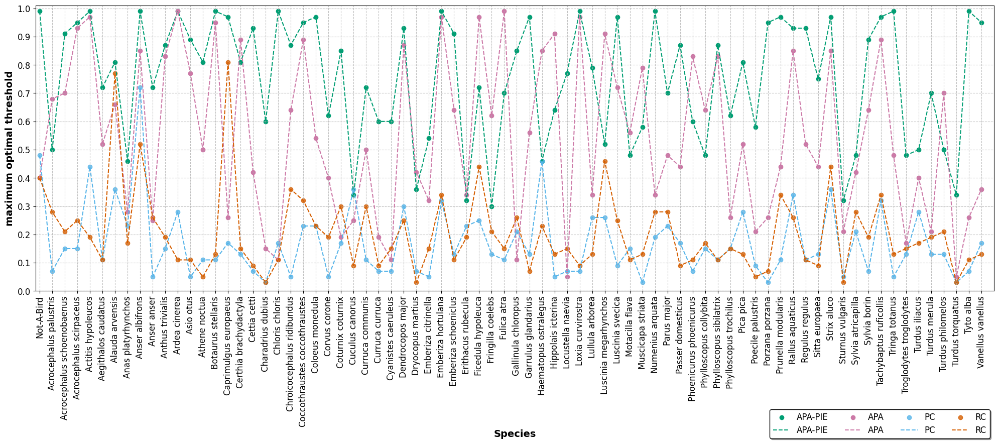

In [39]:
with plt.style.context('seaborn-v0_8-colorblind'):
    _ = plt.figure(figsize=(20, 4.8*2), tight_layout=True)
    plt.scatter(np.arange(num_classes)*3, tuned_test_metric_multipeak_pie['test_decision_threshold'], c='C1', label='APA-PIE', alpha=1.)  # APA-PIE: Autopool Peak-Aggregation + Partial Instance Exchange
    plt.plot(np.arange(num_classes)*3, tuned_test_metric_multipeak_pie['test_decision_threshold'], c='C1', label='APA-PIE', linestyle='--')  # APA-PIE: Autopool Peak-Aggregation + Partial Instance Exchange
    plt.scatter(np.arange(num_classes)*3, tuned_test_metric_multipeak['test_decision_threshold'], c='C3', label='APA', alpha=1.)  # APA: Autopool Peak-Aggregation
    plt.plot(np.arange(num_classes)*3, tuned_test_metric_multipeak['test_decision_threshold'], c='C3', label='APA', linestyle='--')  # APA: Autopool Peak-Aggregation
    plt.scatter(np.arange(num_classes)*3, tuned_test_metric_peak['test_decision_threshold'], c='C5', label='PC', alpha=.8)  # Peak-Crop
    plt.plot(np.arange(num_classes)*3, tuned_test_metric_peak['test_decision_threshold'], c='C5', label='PC', linestyle='--')  # Peak-Crop
    plt.scatter(np.arange(num_classes)*3, tuned_test_metric_rand['test_decision_threshold'], c='C2', label='RC', alpha=.8)  # Random-Crop
    plt.plot(np.arange(num_classes)*3, tuned_test_metric_rand['test_decision_threshold'], c='C2', label='RC', linestyle='--', alpha=1.)  # Random-Crop
    plt.ylim(0, 1.01)
    plt.xlim(-1, num_classes*3)
    plt.grid(alpha=0.8, linestyle='--')
    plt.ylabel('maximum optimal threshold', fontsize=14, fontweight='heavy')
    plt.xlabel('Species', fontsize=14, fontweight='heavy')
    
    plt.xticks(np.arange(num_classes)*3, label2name.values(), rotation=90, fontsize=12)
    plt.yticks(np.linspace(0, 1, 11).round(1), np.linspace(0, 1, 11).round(1), fontsize=12)#, fontweight='bold')
    plt.legend(prop={'size': 'large', 'weight':'medium'}, fancybox=True, edgecolor='k', shadow=True, framealpha=1., ncols=4, bbox_to_anchor=(1, -.4))
    # plt.savefig(save2path, dpi=dpi, format=save_format, bbox_inches='tight')
    plt.show()

**Posterior plots**

In [54]:
# for each type of model and for how many runs you have trained/want, load the test chaches
# replace these with your own test_cache pathes
# we first average the posteriors/predictions then group them. You get the same result as doing it for each run and then average, but faster.

Y = []  # we need one of them, but I keep all of the ground saved truthes to make sure samples are in the same order, for example, to get differences correctly.

test_cache_multipeak_pie_pathes = ['logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_09_11_38_37_test_cache.npy']
y_pred_avg_multipeak_pie = []
for p in test_cache_multipeak_pie_pathes:
    c = np.load(p, allow_pickle=True).item()
    y_pred_avg_multipeak_pie.append(c['y_pred'])
    Y.append(c['y_true'])
y_pred_avg_multipeak_pie = np.stack(y_pred_avg_multipeak_pie).mean(axis=0)

test_cache_multipeak_pathes = ['logs/multi_peak8_1query_autopool_3sec_100epochs_2025_02_07_17_58_06_test_cache.npy']
y_pred_avg_multipeak = []
for p in test_cache_multipeak_pathes:
    c = np.load(p, allow_pickle=True).item()
    y_pred_avg_multipeak.append(c['y_pred'])
    Y.append(c['y_true'])
y_pred_avg_multipeak = np.stack(y_pred_avg_multipeak).mean(axis=0)


test_cache_peak_pathes = ['logs/peak_3sec_100epochs_2025_02_10_17_40_09_test_cache.npy']
y_pred_avg_peak = []
for p in test_cache_peak_pathes:
    c = np.load(p, allow_pickle=True).item()
    y_pred_avg_peak.append(c['y_pred'])
    Y.append(c['y_true'])
y_pred_avg_peak = np.stack(y_pred_avg_peak).mean(axis=0)


test_cache_rand_pathes = ['logs/random_3sec_100epochs_2025_02_10_10_25_22_test_cache.npy']
y_pred_avg_rand = []
for p in test_cache_rand_pathes:
    c = np.load(p, allow_pickle=True).item()
    y_pred_avg_rand.append(c['y_pred'])
    Y.append(c['y_true'])
y_pred_avg_rand = np.stack(y_pred_avg_rand).mean(axis=0)

y_true = Y[0].copy()
for yi in Y:
    assert (y_true == yi).all()
del Y

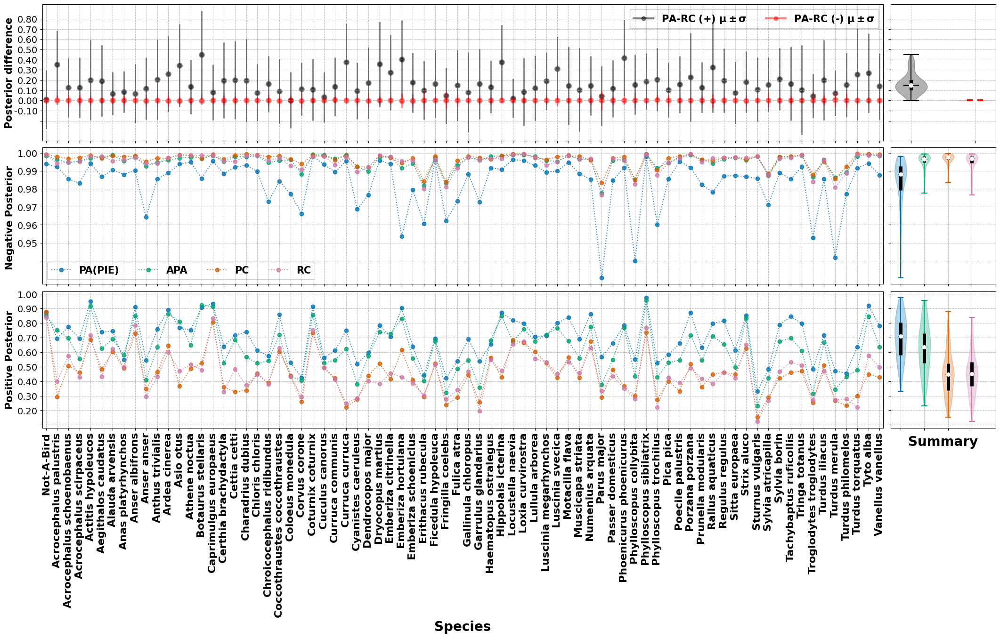

In [75]:
with plt.style.context('seaborn-v0_8-colorblind'):
    fig = plt.figure(figsize=(6.4*3.3, 4.8*2.8), layout="constrained")
    grid = plt.GridSpec(3, 2, figure=fig, width_ratios=[8, 1], wspace=0.)
    ax1 = fig.add_subplot(grid[2, 0])
    ax2 = fig.add_subplot(grid[2, 1], sharey=ax1)
    ax3 = fig.add_subplot(grid[1, 0], sharex=ax1)
    ax4 = fig.add_subplot(grid[1, 1], sharey=ax3, sharex=ax2)
    ax5 = fig.add_subplot(grid[0, 0], sharex=ax1)
    ax6 = fig.add_subplot(grid[0, 1], sharey=ax5)
    colors = ['C0', 'C1', 'C2', 'C3',]
    legends = ['PA(PIE)', 'APA', 'PC', 'RC']
    handles = []
    for i, y in enumerate([y_pred_avg_multipeak_pie, y_pred_avg_multipeak, y_pred_avg_peak, y_pred_avg_rand]):
        post_avg_per_class_pos, post_avg_per_class_neg = [], []
        post_pos, post_neg = get_avg_posterior(y_true, y, name2label, per_class_std=False)
        post_avg_per_class_pos = np.array([v for k, v in post_pos.items() if k not in ['mu', 'std']])
        post_avg_per_class_neg = np.array([v for k, v in post_neg.items() if k not in ['mu', 'std']])
        
        _, = ax1.plot(np.arange(num_classes)*3, post_avg_per_class_pos, c=colors[i], marker='o', linestyle='dotted', label=legends[i], alpha=0.8)
        handles.append(_)
        ax3.plot(np.arange(num_classes)*3, post_avg_per_class_neg, c=colors[i], marker='o', linestyle='dotted', alpha=0.8)
        
        parts = ax2.violinplot([post_avg_per_class_pos.copy()], positions=[i], showmedians=True)
        for k, pc in parts.items():
            if k == 'bodies':
                pc = pc[0]
            pc.set_facecolor(colors[i])
            pc.set_edgecolor(colors[i])
        q1, med, q3 = np.percentile(post_avg_per_class_pos, [25, 50, 75])
        ax2.scatter(i, med, marker='o', color='white', s=30, zorder=3)
        ax2.vlines(i, q1, q3, color='k', linestyle='-', lw=5)
        
        parts = ax4.violinplot([post_avg_per_class_neg.copy()], positions=[i], showmedians=True)
        for k, pc in parts.items():
            if k == 'bodies':
                pc = pc[0]
            pc.set_facecolor(colors[i])
            pc.set_edgecolor(colors[i])
        q1, med, q3 = np.percentile(post_avg_per_class_neg, [25, 50, 75])
        ax4.scatter(i, med, marker='o', color='white', s=30, zorder=3)
        ax4.vlines(i, q1, q3, color='k', linestyle='-', lw=5)
        
    post_diff_summary = get_avg_posterior_difference(y_true, y_pred_avg_multipeak, y_pred_avg_rand)
    diffs_pos, diffs_neg = [], []
    ax5.scatter(np.arange(num_classes)*3, post_diff_summary['diff_positive_mu'], c='black', marker='o', linewidth=3, alpha=.5)
    ax5.scatter(np.arange(num_classes)*3, post_diff_summary['diff_negative_mu'], c='red', marker='o', linewidth=3, alpha=.5)
    ax5.vlines(np.arange(num_classes)*3, 
               post_diff_summary['diff_positive_mu'] + post_diff_summary['diff_positive_sigma'],
               post_diff_summary['diff_positive_mu'] - post_diff_summary['diff_positive_sigma'],
               linewidth=2, alpha=.5, colors='black')
    ax5.vlines(np.arange(num_classes)*3,
               post_diff_summary['diff_negative_mu'] + post_diff_summary['diff_negative_sigma'],
               post_diff_summary['diff_negative_mu'] - post_diff_summary['diff_negative_sigma'],
               linewidth=2, alpha=.5, colors='red')
    
    blk_line = plt.Line2D([], [], c='black', marker='o', linewidth=3, alpha=.5, label='PA-RC (+) $\mathbf{\mu\pm\sigma}$', linestyle='solid')
    red_line = plt.Line2D([], [], c='red', marker='o', linewidth=3, alpha=.5, label='PA-RC (-) $\mathbf{\mu\pm\sigma}$', linestyle='solid')
    
    parts = ax6.violinplot([post_diff_summary['diff_positive_mu']], positions=[0], showmedians=True)
    for k, pc in parts.items():
        if k == 'bodies':
            pc = pc[0]
        pc.set_facecolor('black')
        pc.set_edgecolor('black')
        q1, med, q3 = np.percentile(post_diff_summary['diff_positive_mu'], [25, 50, 75])
        ax6.scatter(0, med, marker='o', color='white', s=30, zorder=3)
        ax6.vlines(0, q1, q3, color='k', linestyle='-', lw=5)
    parts = ax6.violinplot([post_diff_summary['diff_negative_mu']], positions=[1], showmedians=True)
    for k, pc in parts.items():
        if k == 'bodies':
            pc = pc[0]
        pc.set_facecolor('red')
        pc.set_edgecolor('red')
        q1, med, q3 = np.percentile(post_diff_summary['diff_negative_mu'], [25, 50, 75])
        ax6.scatter(1, med, marker='o', color='white', s=30, zorder=3)
        ax6.vlines(1, q1, q3, color='k', linestyle='-', lw=5)
    
    ax3.set_ylabel('Negative Posterior ', fontsize=15, fontweight='heavy')
    ax3.set_xticks(np.arange(num_classes)*3)
    ax3.grid(alpha=0.8, linestyle='--')
    ax3.set_xticklabels([])
    plt.setp(ax3.get_xticklabels(), visible=False)
    ytick_label = [str(f)+'0' if f==1 else str(f) for f in np.linspace(0.94, 1, 7).round(2)]
    ax3.set_yticks(np.linspace(0.94, 1, 7).round(2), ytick_label, fontsize=14)
    ax3.yaxis.get_major_ticks()[0].label1.set_visible(False)


    ax5.grid(alpha=0.8)
    ax5.set_ylabel('Posterior difference', fontsize=15, fontweight='heavy', labelpad=0)
    ax5.set_xticks(np.arange(num_classes)*3)
    ax5.grid(alpha=0.8, linestyle='--')
    ax5.set_xticklabels([])
    plt.setp(ax5.get_xticklabels(), visible=False)
    ytick_label = ['-0.20', '-0.10', '0.00', '0.10','0.20', '0.30', '0.40', '0.50', '0.60', '0.70', '0.80']
    ax5.set_yticks(np.linspace(-0.2, .8, 11).round(1), ytick_label, fontsize=14)
    ax5.yaxis.get_major_ticks()[0].label1.set_visible(False)
    ax5.legend(handles=[blk_line, red_line], prop={'size': 15, 'weight':'bold'}, fancybox=False, edgecolor='k', shadow=False, framealpha=.2, ncols=2)
    
    ax1.set_xlim(-1, num_classes*3-2)
    ax1.set_ylabel('Positive Posterior', fontsize=15, fontweight='heavy')  # labelpad=10
    ax1.set_xlabel('Species', fontsize=20, fontweight='heavy')
    ax1.set_xticks(np.arange(num_classes)*3, list(name2label.keys()), rotation=90, fontsize=16, fontweight='bold')
    ytick_label = [str(f)+'0' for f in np.linspace(0.1, 1, 10).round(2)]
    ax1.set_yticks(np.linspace(0.1, 1, 10).round(2), ytick_label, fontsize=14)
    ax1.grid(alpha=0.8, linestyle='--')
    ax1.yaxis.get_major_ticks()[0].label1.set_visible(False)
    ax3.legend(handles=handles, prop={'size': 15, 'weight':'bold'}, fancybox=False, edgecolor='k', shadow=False, framealpha=.2, ncols=5)
    
    ax4.grid(alpha=0.8, linestyle='--')
    ax4.set_xticks(np.arange(5))
    ax4.set_xticklabels([])
    plt.setp(ax4.get_yticklabels(), visible=False)

    ax6.grid(alpha=0.8, linestyle='--')
    ax6.set_xticks(np.arange(2))
    ax6.set_xticklabels([])
    plt.setp(ax6.get_yticklabels(), visible=False)
    
    ax2.set_xlabel("Summary", fontsize=20, fontweight='heavy')
    ax2.grid(alpha=0.8, linestyle='--')
    ax2.set_xticks(np.arange(5))
    ax2.set_xticklabels([])
    plt.setp(ax2.get_yticklabels(), visible=False)
    
    # plt.savefig('posterior_plot.jpg', dpi=600, format='jpg', bbox_inches='tight')
    plt.show()

## Attention Maps

1) Find a good long recording that peak findings was relatively successful on it to showcase. It's better if there is more than one species to see how attention handles them.
2) Plot the full recording and overlap the peaks on the plot
3) Extract the peak windows and feed it to the model to get back the features, attention weights, etc.
4) Plot the windows and their attention weights.

In [ ]:
def plot_sample(df, idx=None, sample_peaks=False, sample_dur=3, sr=32000, figsize=(20, 6), save=False):
    if idx is None:
        idx = random.randrange(0, df.shape[0])  # 5389, ml: 370, 776, 557, 61, 843, 550
    print('idx:', idx)
    uri, dur, y, peaks, gensp, secondary_labels = df.iloc[idx][['path', 'length', 'label', 'peaks', 'gensp', 'label2']]
    if secondary_labels is None:
        secondary_labels = []
    x, sr_ = torchaudio.load(uri=uri)
    x = x.mean(0)
    x = torchaudio.functional.resample(x, sr_, sr, lowpass_filter_width=64, rolloff=0.9475937167399596, resampling_method="sinc_interp_kaiser", beta=14.769656459379492)
    x = x.numpy()
    print(f'#audio samples: {x.shape[0]:_}', f'sample rate: {sr:_}', f'duration (sec): {x.shape[0]/sr:.2f}', f'#peaks: {len(peaks)}',
          f'species (label): {label2name[y]} ({y})', f"background spcesies (labels): {' & '.join([f'{label2name[secondary_labels[i]]} ({secondary_labels[i]})' for i in range(len(secondary_labels))])}", sep='\n')
    x_mel = data_transformer(torch.from_numpy(x).unsqueeze(0)).squeeze((0, 1)).numpy()
    print('mel spectrogram shape: ', x_mel.shape)
    
    fig = plt.figure(figsize=(20, 3), layout='constrained') 
    plt.imshow(x_mel, aspect='auto', origin='lower', cmap=plt.cm.afmhot)
    plt.colorbar(pad=0.005)
    plt.scatter(np.array(peaks) / hop, [75] * len(peaks), marker='*', linewidths=2, s=12**2, facecolors='white', label='peaks')
    plt.legend()
    plt.show()
    
    # extract peak windows and put them in a batch tensor
    if sample_peaks:
        sample_peaks = min(sample_peaks, len(peaks))
        peaks = np.random.choice(peaks, size=sample_peaks, replace=False)
    x_in = []
    for p in peaks:
        offset = int(max(0, p - sample_dur / 2 * sr))  # shift the offset 1.5 second wirth of samples backward from peak, so peak is the center in 3 second window
        x_in.append(torch.tensor(x[offset:offset+sample_dur*sr]))
    x_in = torch.nn.utils.rnn.pad_sequence(x_in, batch_first=True, padding_value=0.)
    x_in = data_transformer(x_in)
    x_in = x_in.unsqueeze(0)  # append a 1 for batch dimension, which puts the peaks on Instance axis 
    with torch.no_grad():
        logits, h_enc, h_agg, atten_weights = model(x_in, return_features=True)
    print(f'{logits.size()}\t   [Batch-size, classes]', 
          f'{h_enc.size()}  [Batch-size, Instances/peaks, features]',
          f'{atten_weights.size()}  [Batch-size, Heads, Queries, Instances]',
          f'{h_agg.size()}\t   [Batch-size, aggregated-features]',
          sep='\n')
    print(f'species (label): {label2name[y]} ({y})', f"background spcesies (labels): {' & '.join([f'{label2name[secondary_labels[i]]} ({secondary_labels[i]})' for i in range(len(secondary_labels))])}", sep='\n')
    print('model predictions ranked by confidence:\n')
    probs = logits.sigmoid()[0]
    ranks = probs.argsort(descending=True).numpy()
    display(pd.DataFrame({'species': [label2name[i] for i in ranks], 'probs': [probs[i].round(decimals=2).item() for i in ranks]}, index=ranks).T)
    
    num_instances = atten_weights.shape[-1]
    num_heads = atten_weights.shape[1]
    x_in = x_in.squeeze((0, 2))  # get rid of batch and channel axes
    atten_weights = atten_weights.squeeze((0, 2))  # get rid of batch and query axes, note this is not with per_class_query, otherwise each class had a different attention weights
    
    fig = plt.figure(figsize=figsize, layout="constrained")
    grid = plt.GridSpec(1+num_heads, num_instances, figure=fig, height_ratios=[8] + 8 * [1])
    
    # plot instances in a train window
    x_vis = torch.chunk(x_in, num_instances)  # separate peak windows
    x_vis = [F.pad(xip, (0, 10)) for xip in x_vis[:-1]] + [x_vis[-1]]  # pad between windows for better visualization.
    x_vis = torch.cat(x_vis, dim=-1).squeeze().numpy()  # make a train window
    
    ax = fig.add_subplot(grid[0, :])
    ax.imshow(x_vis, aspect='auto', origin='lower', cmap=plt.cm.inferno)
    ax.set_axis_off()
    
    # heads weights for each instance
    text_x_frac = 1 / num_instances
    for h in range(0, num_heads):
        ax = fig.add_subplot(grid[1+h, :])
        ax.imshow(atten_weights[h].reshape(1, -1), aspect='auto', origin='lower', cmap=plt.cm.coolwarm)
        for i in range(num_instances):
            ax.text(text_x_frac/5+i*text_x_frac, 0.3, f'{atten_weights[h, i].item():.3f}', color='white', bbox={'facecolor': 'black', 'alpha': 0.5, 'pad': 1}, fontweight='bold', fontsize=20, transform=ax.transAxes)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_ylabel(f'T{h+1}={model.agg.tau.data[h].item():.3f}', rotation='horizontal', ha='right', va='center', fontweight='bold', fontsize=20)
    if save:
        plt.savefig(f"plots/attention_heatmap_{uri.split('/')[-1].split('.')[0]}.jpg", dpi=300, format='jpg', pad_inches=0, bbox_inches='tight')
    plt.show()

In [43]:
device = 'cpu'
model = EffNetB1(num_classes, peak_agg=True, per_class_query=False, autopool=True, num_heads=8)
model.load_state_dict(torch.load('logs/multi_peak8_1query_autopool_pie_3sec_100epochs_2025_02_09_11_38_37_state.pt'))  # replace the path with an aggregation modle of your own
model.to(device).eval()
data_transformer = DataTransformer(n_fft=1024, hop_length=256, n_mels=80)
data_transformer.to(device)
data_transformer.requires_grad_(False)
hop = data_transformer.hop_length

In [44]:
ml_train_df = train_df[~train_df.label2.isna()].reset_index(drop=True)  # get multilabel samples for the sake of visualization
ml_train_df.length.describe()

count    1439.000000
mean       59.511959
std        54.604268
min         0.408000
25%        22.967500
50%        41.040000
75%        76.095000
max       298.136000
Name: length, dtype: float64

idx: 1266
#audio samples: 4_332_565
sample rate: 32_000
duration (sec): 135.39
#peaks: 126
species (label): Hippolais icterina (41)
background spcesies (labels): Phylloscopus trochilus (55) & Luscinia megarhynchos (45) & Sylvia borin (66) & Phylloscopus collybita (53) & Curruca communis (26)
mel spectrogram shape:  (80, 16925)


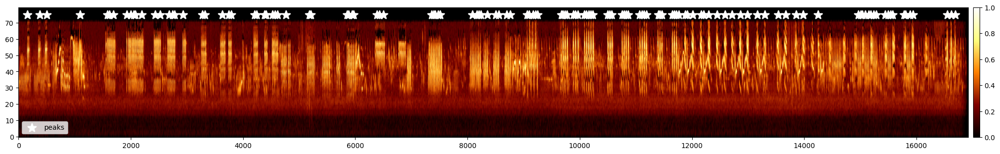

torch.Size([1, 76])	   [Batch-size, classes]
torch.Size([1, 16, 1280])  [Batch-size, Instances/peaks, features]
torch.Size([1, 8, 1, 16])  [Batch-size, Heads, Queries, Instances]
torch.Size([1, 1280])	   [Batch-size, aggregated-features]
species (label): Hippolais icterina (41)
background spcesies (labels): Phylloscopus trochilus (55) & Luscinia megarhynchos (45) & Sylvia borin (66) & Phylloscopus collybita (53) & Curruca communis (26)
model predictions ranked by confidence:



,41,26,66,45,55,53,71,69,50,65,9,36,22,56,42,25,23,37,72,75,33,59,28,34,2,3,39,19,29,7,51,27,52,20,40,44,64,68,70,60,31,6,47,1,11,73,10,5,38,57,67,17,14,16,49,62,8,4,46,12,18,63,13,48,35,74,61,58,32,15,21,30,54,24,43,0
species,Hippolais icterina,Curruca communis,Sylvia borin,Luscinia megarhynchos,Phylloscopus trochilus,Phylloscopus collybita,Turdus merula,Troglodytes troglodytes,Parus major,Sylvia atricapilla,Anser anser,Fringilla coelebs,Coloeus monedula,Pica pica,Locustella naevia,Cuculus canorus,Corvus corone,Fulica atra,Turdus philomelos,Vanellus vanellus,Emberiza schoeniclus,Prunella modularis,Cyanistes caeruleus,Erithacus rubecula,Acrocephalus schoenobaenus,Acrocephalus scirpaceus,Garrulus glandarius,Chloris chloris,Dendrocopos major,Anas platyrhynchos,Passer domesticus,Curruca curruca,Phoenicurus phoenicurus,Chroicocephalus ridibundus,Haematopus ostralegus,Lullula arborea,Sturnus vulgaris,Tringa totanus,Turdus iliacus,Rallus aquaticus,Emberiza citrinella,Alauda arvensis,Motacilla flava,Acrocephalus palustris,Ardea cinerea,Turdus torquatus,Anthus trivialis,Aegithalos caudatus,Gallinula chloropus,Poecile palustris,Tachybaptus ruficollis,Cettia cetti,Botaurus stellaris,Certhia brachydactyla,Numenius arquata,Sitta europaea,Anser albifrons,Actitis hypoleucos,Luscinia svecica,Asio otus,Charadrius dubius,Strix aluco,Athene noctua,Muscicapa striata,Ficedula hypoleuca,Tyto alba,Regulus regulus,Porzana porzana,Emberiza hortulana,Caprimulgus europaeus,Coccothraustes coccothraustes,Dryocopus martius,Phylloscopus sibilatrix,Coturnix coturnix,Loxia curvirostra,Not-A-Bird
probs,0.99,0.98,0.89,0.89,0.63,0.57,0.32,0.19,0.17,0.14,0.13,0.11,0.06,0.06,0.06,0.06,0.06,0.05,0.05,0.05,0.04,0.03,0.03,0.02,0.01,0.01,0.01,0.01,0.01,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


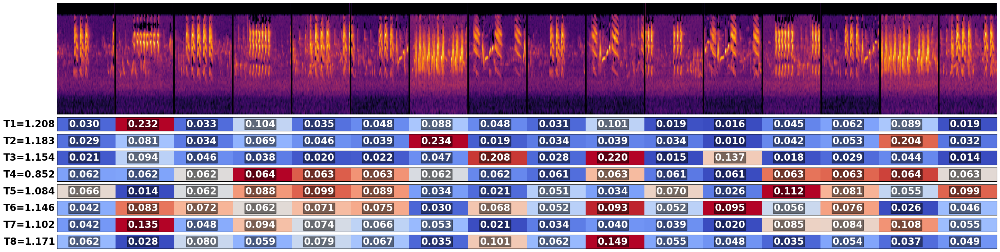

In [45]:
# Some recordings have many peaks, some a few, some 1, some have good peak locations, some don't...you gotta try a few
# comment random seed to get random peak sampling on each call. if you want to save a particular plot with certain sampled peaks, keep the random.seed on and change the seed value to get different persistent peaks.
np.random.seed(31)
plot_sample(ml_train_df, idx=1266, sample_peaks=16, figsize=(6.4*4.5, 4.8*1.5), save=False)

# End